# Machine Learning - Recommender System

---

#### Load  Data & libraries

In [7]:
import numpy as np
import pandas as pd
import seaborn as sns
import dtale

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import iplot, init_notebook_mode

from sklearn.cluster import KMeans
from pyproj import CRS, Transformer
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler

In [8]:
data = pd.read_csv('../Divar Dataset/Divar.csv')
data.drop('Unnamed: 0', axis=1, inplace=True)

/var/folders/9y/lpsdwq1d0bz2t5178sr1rgmr0000gn/T/ipykernel_41006/1300283319.py:1: DtypeWarning:

Columns (11,27,29,53) have mixed types. Specify dtype option on import or set low_memory=False.



In [3]:
# # d-tale
# d = dtale.show(data)
# d.open_browser()

## Part 1 <br>
Clustering Using K-Means with 10 Clusters

#### Preprocessing

**Features to select:** `location_latitude`, `location_longitude`, and `price_value`

In [9]:
# Feature selection
part_1_data = data[['location_latitude', 'location_longitude', 'price_value', 'building_size', 'construction_year']]
part_1_data.shape

(1000000, 5)

Handling Missings:

In [10]:
part_1_data = part_1_data.dropna()
part_1_data.shape

(300855, 5)

In [106]:
# Digits conversion to english
def persian_to_english_digits(text):
    if pd.isna(text):
        return text

    persian_digits = "۰۱۲۳۴۵۶۷۸۹"
    english_digits = "0123456789"

    translation_table = str.maketrans(persian_digits, english_digits)
    return str(text).translate(translation_table)


part_1_data['construction_year'] = part_1_data.loc[:, 'construction_year'].apply(
    lambda x: persian_to_english_digits(x) if isinstance(x, str) else x)

# change to only digits
part_1_data['construction_year'] = part_1_data['construction_year'].replace('قبل از 1370', '1370')

# change to numeric type
part_1_data['construction_year'] = pd.to_numeric(part_1_data['construction_year'], errors='coerce')
part_1_data['construction_year'].shape

(300855,)

In [107]:
import jdatetime

current_jalali_year = jdatetime.date.today().year

part_1_data["building_age"] = current_jalali_year - part_1_data["construction_year"]
part_1_data = part_1_data.drop("construction_year", axis=1)

In [108]:
part_1_data.describe()

,location_latitude,location_longitude,price_value,building_size,building_age
count,300855.000000,300855.000000,3.008550e+05,3.008550e+05,300855.000000
mean,35.146506,51.548638,1.780105e+10,2.052470e+03,9.842020
std,2.188236,3.018498,5.972403e+11,9.999115e+04,8.563601
min,23.636976,43.135620,0.000000e+00,1.000000e+00,1.000000
25%,35.324881,50.829792,1.750000e+09,7.200000e+01,2.000000
50%,35.725277,51.334305,3.200000e+09,9.500000e+01,8.000000
75%,36.301340,51.757870,6.250000e+09,1.350000e+02,15.000000
max,40.358055,62.639378,1.000000e+14,1.000000e+07,34.000000


Convert geographical coordinates to UTM format:

In [109]:
# Create and find UTM zones
part_1_data['utm_zone'] = (np.floor((part_1_data['location_longitude'] + 180) / 6) + 1).astype(int)

print("Zones are: ", part_1_data['utm_zone'].unique())

Zones are:  [39 40 38 41]


In [110]:
def apply_utm_conversion(group):
    """
    Apply UTM conversion.
    """
    # Extract the UTM zone number
    zone = group.name
    # Define coordinate reference systems
    wgs84_crs = CRS.from_epsg(4326)
    utm_crs = CRS.from_epsg(32600 + zone)

    # Create a coordinate transformer
    transformer = Transformer.from_crs(wgs84_crs, utm_crs, always_xy=True)
    
    # Convert all points in the group
    easting, northing = transformer.transform(
        group['location_longitude'].values,
        group['location_latitude'].values
    )
    
    # Convert all points in the group
    group['utm_easting'] = easting
    group['utm_northing'] = northing
    return group

In [111]:
part_1_data = part_1_data.groupby(['utm_zone'], group_keys=False).apply(apply_utm_conversion, include_groups=False)
part_1_data['utm_zone'] = (np.floor((part_1_data['location_longitude'] + 180) / 6) + 1).astype(int)
part_1_data.head()

,location_latitude,location_longitude,price_value,building_size,building_age,utm_easting,utm_northing,utm_zone
7,35.729832,51.505466,8.700000e+09,100.0,11,545711.558185,3.954101e+06,39
8,35.712364,50.794781,6.500000e+08,78.0,8,481437.130969,3.952066e+06,39
10,35.778664,51.757549,2.600000e+09,87.0,1,568467.028494,3.959664e+06,39
12,36.321831,59.524502,1.299000e+10,169.0,1,726621.357899,4.022603e+06,40
13,32.467804,51.404095,8.500000e+08,16.0,4,537973.973070,3.592362e+06,39


#### Outlier Handling

array([[<Axes: title={'center': 'location_latitude'}>,
        <Axes: title={'center': 'location_longitude'}>,
        <Axes: title={'center': 'price_value'}>],
       [<Axes: title={'center': 'building_size'}>,
        <Axes: title={'center': 'building_age'}>,
        <Axes: title={'center': 'utm_easting'}>],
       [<Axes: title={'center': 'utm_northing'}>,
        <Axes: title={'center': 'utm_zone'}>, <Axes: >]], dtype=object)

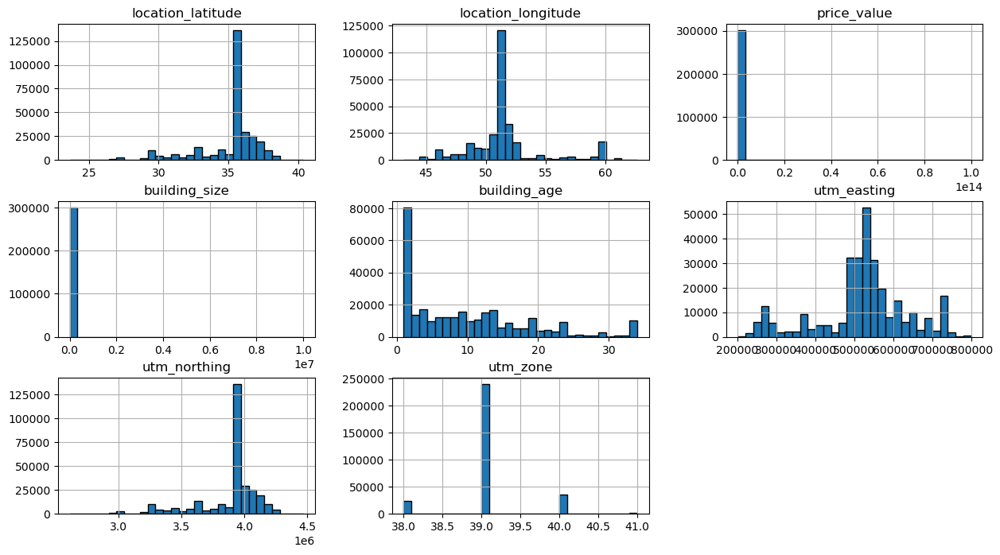

In [112]:
part_1_data.hist(figsize=(15, 8), bins=30, edgecolor='black')

In [114]:
# Import yea_johnson power transformer
from sklearn.preprocessing import PowerTransformer

# Initialize the transformer
pt = PowerTransformer(method='yeo-johnson')
cols_to_transform = ['price_value', 'building_size']
pt.fit(part_1_data[cols_to_transform])
# Apply the transformation  
part_1_data[cols_to_transform] = pt.transform(part_1_data[cols_to_transform])

#### Feature Scaling

Feature Scaling to have better clustering using K-means.

In [115]:
# Feature Scaling on the Features : utm_easting , utm_northing, price_value
scaler = StandardScaler()

part_1_data_scaled = scaler.fit_transform(part_1_data[['utm_easting', 'utm_northing', 'price_value', 'building_age', 'building_size']])
part_1_data_scaled = pd.DataFrame(part_1_data_scaled, columns=['utm_easting', 'utm_northing', 'price_value', 'building_age', 'building_size'])
part_1_data_scaled.head()

,utm_easting,utm_northing,price_value,building_age,building_size
0,0.213692,0.263974,0.687957,0.135221,0.028183
1,-0.344182,0.255581,-0.986976,-0.215099,-0.309807
2,0.411200,0.286911,-0.185990,-1.032514,-0.159510
3,1.783911,0.546419,1.021014,-1.032514,0.696389
4,0.146533,-1.227530,-0.846663,-0.682193,-2.803916


#### Train K-Means Model for Clustering<br>

In [116]:
clustering_features = part_1_data_scaled

km = KMeans(n_clusters=10, random_state=42, n_init=10)
part_1_data['cluster_number'] = km.fit_predict(clustering_features)

# Finding Clusters Centroids
centroids_scaled = km.cluster_centers_

In [117]:
part_1_data['cluster_number'].value_counts()

cluster_number
1    76540
7    53802
0    42511
6    26998
8    26212
5    25822
2    17665
4    17357
9     8968
3     4980
Name: count, dtype: int64

In [118]:
# Inverse Scaling cluster centroids
centroids = scaler.inverse_transform(centroids_scaled)

centroids_df = pd.DataFrame(
    centroids,
    columns=["utm_easting", "utm_northing", "price_value", "building_age", "building_size"]
)

In [119]:
centroids_utm = (
    part_1_data
    .groupby("cluster_number")[["utm_easting", "utm_northing"]]
    .mean()
    .reset_index()
)

centroids_utm["utm_zone"] = (
    part_1_data
    .groupby("cluster_number")["utm_zone"]
    .agg(lambda x: x.mode().iloc[0])
    .values
)

In [120]:
from pyproj import Transformer

latitudes = []
longitudes = []

for _, row in centroids_utm.iterrows():
    zone = int(row["utm_zone"])
    
    transformer = Transformer.from_crs(
        f"EPSG:326{zone}",  # UTM zone
        "EPSG:4326",        # WGS84
        always_xy=True
    )
    
    lon, lat = transformer.transform(
        row["utm_easting"],
        row["utm_northing"]
    )
    
    latitudes.append(lat)
    longitudes.append(lon)

centroids_utm["latitude"] = latitudes
centroids_utm["longitude"] = longitudes

In [121]:
import geopandas as gpd

# Build GeoDataFrame in WGS84
gdf = gpd.GeoDataFrame(
    part_1_data,
    geometry=gpd.points_from_xy(
        part_1_data["location_longitude"],
        part_1_data["location_latitude"]
    ),
    crs="EPSG:4326"
)

# Load Iran border (Natural Earth)
iran = gpd.read_file(
    "https://naturalearth.s3.amazonaws.com/110m_cultural/ne_110m_admin_0_countries.zip"
)
iran = iran[iran["NAME"] == "Iran"].to_crs("EPSG:4326")

# Spatial filter
iran_geom = iran.geometry.iloc[0]
gdf = gdf[gdf.within(iran_geom)].copy()

In [122]:
import plotly.express as px

# Force cluster_number to be categorical by converting it to string
# gdf["cluster_number"] = gdf["cluster_number"].astype(str)

# palette = sns.color_palette("Set2", 10).as_hex()

# cluster_colors = {
#     0: "#264653",  # deep blue-gray
#     1: "#2A9D8F",  # dark teal
#     2: "#1B4332",  # dark green
#     3: "#9B2226",  # dark red
#     4: "#5A189A",  # deep purple
#     5: "#7F5539",  # dark brown
#     6: "#C9184A",  # dark magenta
#     7: "#495057",  # charcoal gray
#     8: "#B08900",  # dark mustard
#     9: "#005F73",  # dark cyan
# }

fig = px.scatter_map(
    gdf,
    lat="location_latitude",
    lon="location_longitude",
    color="cluster_number",
    # color_discrete_sequence=palette,
    hover_data={
        "price_value": True,
        "utm_easting": ":.0f",
        "utm_northing": ":.0f",
        "location_latitude": False,
        "location_longitude": False,
    },
    map_style="open-street-map",
    zoom=3,
    center={"lat": 32.4279, "lon": 53.6880},
    title="K-Means Clusters (k=10) — Filtered to Iran<br><sup>Clustering done in UTM space</sup>",
    width=1550,
    height=800,
)

fig.add_trace(
    go.Scattermap(
        lat=centroids_utm["latitude"],
        lon=centroids_utm["longitude"],
        mode="markers+text",
        marker=dict(
            size=40,
            color="#000000",
            symbol="x"
        ),
    
        text=[f"C{i}" for i in centroids_utm["cluster_number"]],
        textposition="top center",
        hoverinfo="text",
        hovertext=[
            f"Cluster {row.cluster_number}<br>"
            f"UTM Easting: {row.utm_easting:,.0f}<br>"
            f"UTM Northing: {row.utm_northing:,.0f}"
            for _, row in centroids_utm.iterrows()
        ]
    )
)

fig.update_traces(
   marker=dict(size=7) 
)

fig.show()

---

## Part 2 <br>
